### 3. SVD of Quantum Thermal States (16 points)

Consider the HDF5 file provided in Canvas for this exercise, `ThermalMatrices.h5`. This file contains two matrices, `T10` and `T100`, of dimension 2048 × 2048. The matrices represent the quantum states (density matrices) of a system of 11 spins, at temperatures \( T = 10J \) and \( T = 100J \) respectively (\( J \) is the hopping energy in the system). Please provide the solution of the following problems in a Jupyter Notebook.

#### (a) Calculate the SVD of both matrices, and plot their normalized singular values in the same figure (4 points).


In [1]:
using ITensors          # For tensor computations
using Plots             # For plotting
using LinearAlgebra     # For linear algebra operations
using HDF5              # For reading HDF5 files


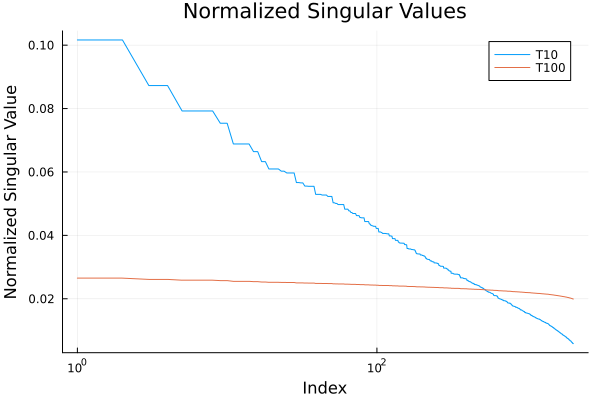

In [26]:
# Load the matrices from the HDF5 file
file = h5open("ThermalMatrices.h5", "r")
T10 = read(file, "T10")
T100 = read(file, "T100")
close(file)

# Calculate the SVD
U10, S10, V10 = svd(T10)
U100, S100, V100 = svd(T100)

# Normalize the singular values
S10_norm = S10 / sqrt(sum(S10.^2))
S100_norm = S100 / sqrt(sum(S100.^2))

# Plot the normalized singular values
plot(1:length(S10_norm), S10_norm, label="T10", xlabel="Index", ylabel="Normalized Singular Value",xscale =:log10 ,title="Normalized Singular Values")
plot!(1:length(S100_norm), S100_norm,xscale = :log10,label="T100")


#### (b) Compress both matrices so the truncation error is approximately 1%. How many singular values need to be kept for each matrix to achieve this? (4 points)


In [27]:
function num_singular_values_to_keep(S, error_threshold)
    cumulative_sum = cumsum(S)
    total_sum = sqrt(sum(S.^2))
    for i in 1:length(S)
        if cumulative_sum[i] / total_sum >= (1 - error_threshold)
            return i
        end
    end
    return length(S)
end

# Determine the number of singular values to keep for 1% truncation error
error_threshold = 0.01
num_sv_T10 = num_singular_values_to_keep(S10_norm, error_threshold)
num_sv_T100 = num_singular_values_to_keep(S100_norm, error_threshold)

println("Number of singular values to keep for T10: ", num_sv_T10)
println("Number of singular values to keep for T100: ", num_sv_T100)

# Truncate the matrices
T10_truncated = U10[:, 1:num_sv_T10] * Diagonal(S10[1:num_sv_T10]) * V10[:, 1:num_sv_T10]';
T100_truncated = U100[:, 1:num_sv_T100] * Diagonal(S100[1:num_sv_T100]) * V100[:, 1:num_sv_T100]';

Number of singular values to keep for T10: 13
Number of singular values to keep for T100: 40


#### (c) Compare the eigenvalues of `T10` with those of its truncated version (4 points).


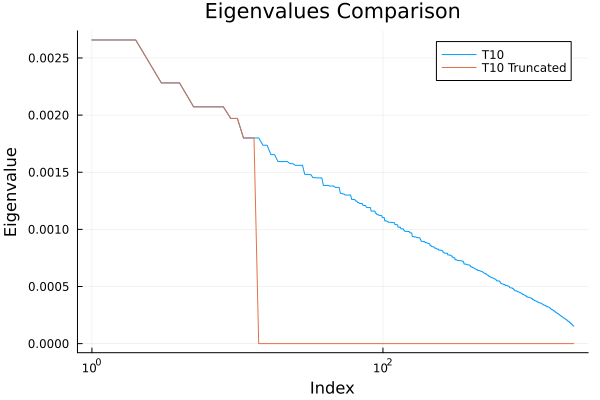

In [28]:
# Calculate eigenvalues
eigvals_T10 = eigvals(T10)
eigvals_T10_truncated = eigvals(T10_truncated)

# Plot the eigenvalues
plot(1:length(eigvals_T10), sort(real(eigvals_T10), rev=true), label="T10", xlabel="Index", ylabel="Eigenvalue",title="Eigenvalues Comparison",xscale = :log10)
plot!(1:length(eigvals_T10_truncated), sort(real(eigvals_T10_truncated),rev=true), label="T10 Truncated",xscale = :log10)

#### (d) Calculate the von Neumann entropy of the matrices `T10` and `T100` (4 points).

In [5]:
# Function to calculate von Neumann entropy
function von_neumann_entropy(matrix)
    eigvals = eigen(matrix).values
    entropy = -sum(eigvals .* log.(eigvals))
    return entropy
end

# Calculate the von Neumann entropy
entropy_T10 = von_neumann_entropy(T10)
entropy_T100 = von_neumann_entropy(T100)

println("Von Neumann entropy of T10: ", entropy_T10)
println("Von Neumann entropy of T100: ", entropy_T100)

Von Neumann entropy of T10: 7.459116059789881
Von Neumann entropy of T100: 7.62309934232943


### 4. Polar Decomposition (12 points)

The polar decomposition was recently put forward as an alternative to SVD to implement MPS structures on tensor processing units; see Ganahl et al, *PRX Quantum* 4, 010317 (2023). In this decomposition, a matrix \( O \) of dimensions \( m X n \) is written as the product of an isometric \( m X n \) matrix \( P \) and a positive semi-definite Hermitian matrix \( H \) of dimension \( n X n \): 

\[
O = PH
\]

Please provide the solution of the following problems in a Jupyter Notebook.

#### (a) Implement the iterative algorithm described in Appendix A of the article, and apply it to the matrix `T10` of Exercise 3 to obtain its polar decomposition (8 points).




In [33]:
function polar_decomposition_iterative(O; tol=1e-6, maxiter=1000)
    # Initialization
    P = copy(O)
    # No need to define I; use I from LinearAlgebra directly

    # Iterative process
    for k in 1:maxiter
        P_prev = P
        # Update P using the identity operator I
        P = (1/2) * P * (3I - P' * P)
        # Check for convergence
        err = norm(P - P_prev) / norm(P)
        if err < tol
            println("Converged after $k iterations with error $err")
            break
        end
        if k == maxiter
            println("Reached maximum iterations without full convergence.")
        end
    end
    # Compute H
    H = P' * O
    return P, H
end

polar_decomposition_iterative (generic function with 1 method)

In [37]:
P_iter, H_iter = polar_decomposition_iterative(T10);
@show P_iter
@show H_iter

Converged after 26 iterations with error 4.138577751317354e-7
P_iter = [0.9999999999748154 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0

Excessive output truncated after 524359 bytes.

2048×2048 Matrix{Float64}:
 0.000153286   0.0           0.0          …   0.0          0.0
 0.0           0.000191259  -4.20213e-5      -2.86373e-33  0.0
 0.0          -4.20213e-5    0.000237608     -1.8693e-35   0.0
 0.0          -6.25391e-21   3.94633e-22     -2.0139e-33   0.0
 0.0           4.32685e-6   -4.66408e-5       5.47456e-33  0.0
 0.0           1.36915e-20  -1.06565e-20  …  -5.02647e-33  0.0
 0.0           8.54598e-21   1.9115e-21       5.88463e-34  0.0
 0.0          -2.90765e-21  -7.94473e-23      1.14293e-32  0.0
 0.0          -2.92596e-7    4.6342e-6       -1.32829e-34  0.0
 0.0           5.45744e-21  -1.00762e-21      4.32621e-33  0.0
 0.0          -1.71915e-20   2.30678e-20  …   5.01188e-33  0.0
 0.0           1.9278e-21   -4.77745e-21      6.89502e-33  0.0
 0.0           7.94868e-21  -3.50315e-22     -1.4524e-33   0.0
 ⋮                                        ⋱                
 0.0          -5.25678e-21  -1.71472e-22      2.34843e-21  0.0
 0.0           1.44931e-21  -3.

In [35]:
O_reconstructed = P_iter * H_iter
reconstruction_error = norm(T10 - O_reconstructed) / norm(T10)
println("Reconstruction error (iterative method): ", reconstruction_error)

Reconstruction error (iterative method): 1.155378566760996e-12



#### (b) Compare the matrices \( P \) and \( H \) obtained in (a) with those obtained from an SVD of \( O \), using the Frobenius norm of their differences (4 points).

Computing SVD-based polar decomposition...
  4.458818 seconds (16 allocations: 192.250 MiB, 0.35% gc time)
Maximum imaginary part of eigvals_H_iter: 0.0
Maximum imaginary part of eigvals_H_svd: 0.0
Relative Frobenius norm difference for P: 2.1681708905772687e-12
Relative Frobenius norm difference for H: 5.776863658021467e-13


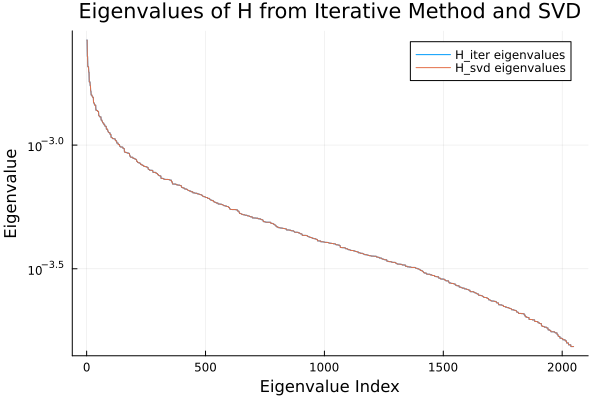

In [36]:
println("Computing SVD-based polar decomposition...")
@time U, Σ, V = svd(T10)

# Compute P and H using SVD
P_svd = U * V'
H_svd = V * Diagonal(Σ) * V'

# Ensure H_iter and H_svd are Hermitian
H_iter = (H_iter + H_iter') / 2
H_svd = (H_svd + H_svd') / 2

# Compute eigenvalues assuming Hermitian matrices
eigvals_H_iter = eigen(Hermitian(H_iter)).values
eigvals_H_svd = eigen(Hermitian(H_svd)).values

# Extract real parts if necessary
eigvals_H_iter = real(eigvals_H_iter)
eigvals_H_svd = real(eigvals_H_svd)

# Sort the eigenvalues in descending order
eigvals_H_iter_sorted = sort(eigvals_H_iter, rev = true)
eigvals_H_svd_sorted = sort(eigvals_H_svd, rev = true)

# Optional: Check the maximum imaginary part
max_imag_eig_H_iter = maximum(abs.(imag(eigvals_H_iter)))
println("Maximum imaginary part of eigvals_H_iter: ", max_imag_eig_H_iter)

max_imag_eig_H_svd = maximum(abs.(imag(eigvals_H_svd)))
println("Maximum imaginary part of eigvals_H_svd: ", max_imag_eig_H_svd)

# Compare P and H from iterative method and SVD
# Compute the differences
P_diff = norm(P_iter - P_svd)
H_diff = norm(H_iter - H_svd)

# Compute the relative differences
P_diff_rel = P_diff / norm(P_svd)
H_diff_rel = H_diff / norm(H_svd)

println("Relative Frobenius norm difference for P: ", P_diff_rel)
println("Relative Frobenius norm difference for H: ", H_diff_rel)

# Plot the eigenvalues
plot(
    1:length(eigvals_H_iter_sorted), eigvals_H_iter_sorted,
    label = "H_iter eigenvalues",
    xlabel = "Eigenvalue Index",
    ylabel = "Eigenvalue",
    yscale = :log10,
    title = "Eigenvalues of H from Iterative Method and SVD"
)
plot!(
    1:length(eigvals_H_svd_sorted), eigvals_H_svd_sorted,
    label = "H_svd eigenvalues"
)
display(current())

# SVD compression of colored photos ##

**Import packages**

In [38]:
using LinearAlgebra
using Plots
using Images
using ITensors

**Load photos**

(1920, 2560)

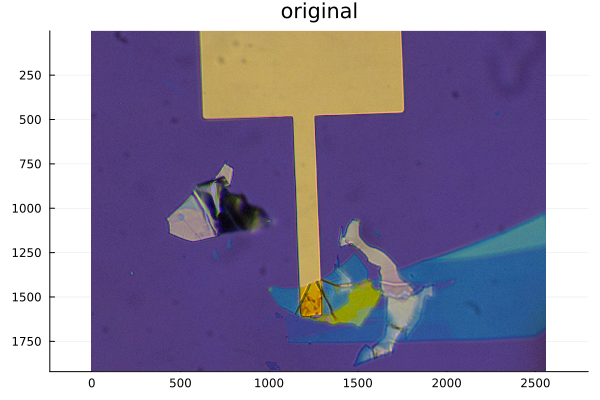

In [39]:
Photo = load("stack14.png");
print(size(Photo))
p1=plot(RGB.(Photo),title="original")
display(p1)



**Display singular values**

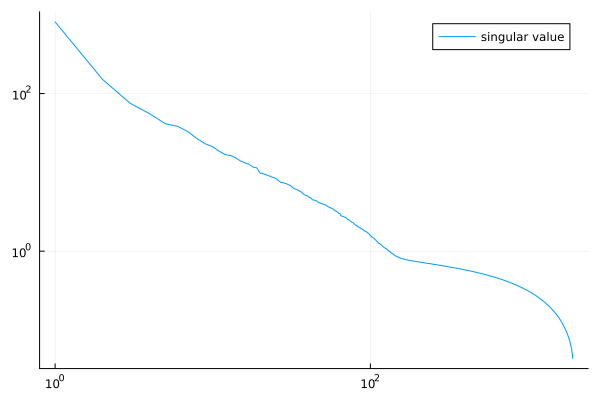

In [40]:
PhotoSVD = svd(Gray.(Photo));
plot(PhotoSVD.S, xaxis=:log, yaxis=:log,label="singular value")

***'<big>'How many singular values will be kept***

In [41]:
χ = 10;

**Compressing images in all three channels**

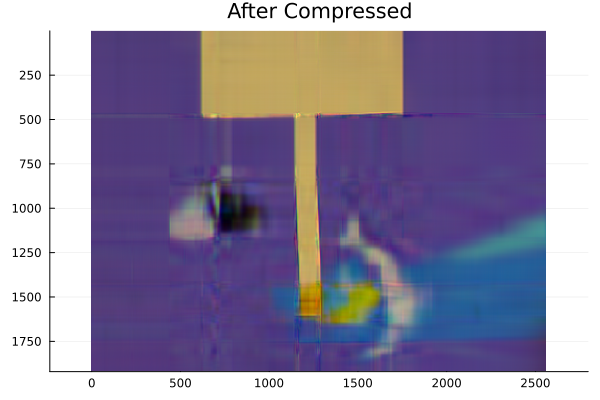

In [42]:

img_CHW = channelview(Photo) 
pho_HWC = permutedims(img_CHW, (2, 3, 1))
Compressed= zeros(size(pho_HWC))
for i = 1:3
    img=pho_HWC[:,:,i];
    PhotoSVD = svd(Gray.(img));
    n = size(PhotoSVD.S,1)
    rem = n-χ;
    # Keep only χ singular values
    Sapprox=Diagonal(copy(PhotoSVD.S));
    for k = 1:rem
        Sapprox[n+1-k,n+1-k]=0;
    end
    Compressed[:,:,i] = PhotoSVD.U*Sapprox*PhotoSVD.Vt;
end
Compressed_rgb = permutedims(Compressed, (3, 1, 2))

# Create RGB image and plot
com_rgb = colorview(RGB, Compressed_rgb)
plot(com_rgb,title="After Compressed")

# ITensor SVD compression #

#### Load images ####

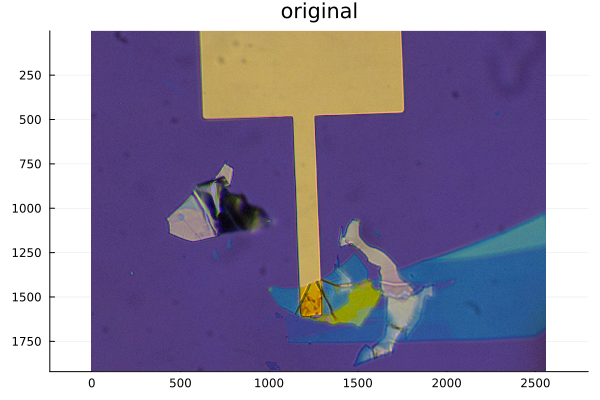

(1920, 2560, 3)

In [43]:
Photo = load("stack14.png");
#print(size(Photo));
p1=plot(RGB.(Photo),title="original");
display(p1);

img_CHW = channelview(Photo) ;
pho_HWC = permutedims(img_CHW, (2, 3, 1));
pho_size=size(pho_HWC)

#### Initialize index

In [44]:
i=Index(pho_size[1]);
j=Index(pho_size[2]);
k=Index(pho_size[3]);
@show i,j,k

(i, j, k) = ((dim=1920|id=347), (dim=2560|id=371), (dim=3|id=593))


((dim=1920|id=347), (dim=2560|id=371), (dim=3|id=593))

#### SVD with merge i,k legs

In [45]:
P=ITensor(pho_HWC,i,j,k);
#@show inds(P)
U,S,V=svd(P,(i,k),cutoff=1E-10,maxdim=10);
truncerr= (norm(U*S*V-P)/norm(P))^2;
@show  truncerr
#@show inds(S)

truncerr = 0.0080356905f0


0.0080356905f0

#### Plot singular values

In [46]:
s1 = commonind(U, S);
s2=  commonind(V, S);

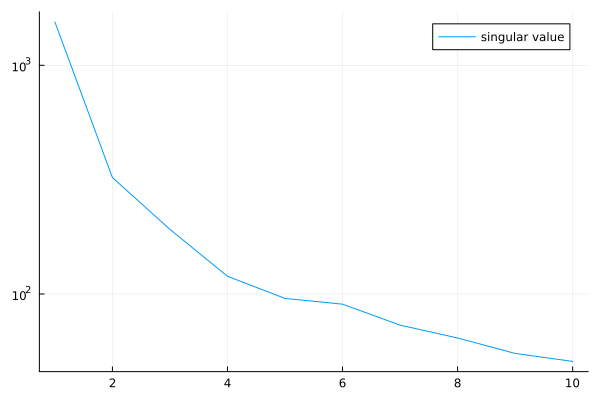

In [47]:
ss=Array(S,s1,s2);
size(ss)
plot(diag(ss), yaxis=:log,label="singular value")

#### Plot compressed photo

In [48]:
P_c=U*S*V;
P_new=Array(P_c,i,j,k);
@show size(P_new)

size(P_new) = (1920, 2560, 3)


(1920, 2560, 3)

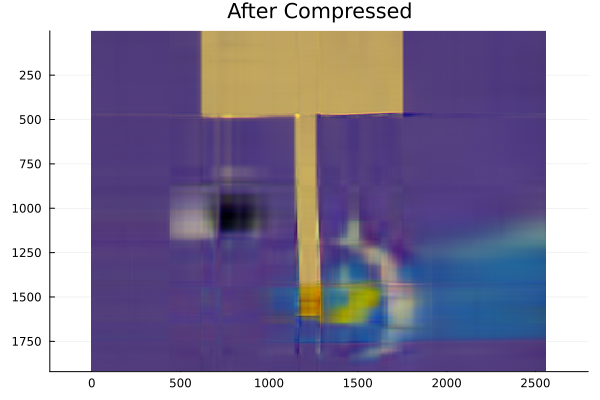

In [49]:
Compressed_rgb = permutedims(P_new, (3, 1, 2))

# Create RGB image and plot
com_rgb = colorview(RGB, Compressed_rgb)
plot(com_rgb,title="After Compressed")

8. 2D function as MPS (16 points)
Please provide the solution of the following problems in a Jupyter Notebook.
a) Encode the function f (x, y) = sin(x + y) cos(xy) as an MPS, in the range x ∈ [0, π] and
y ∈ [0, 2π]. Use N = 7 qubits to define the spatial grid in each dimension (6 points).
b) Which is the maximal bond dimension of the MPS with no truncation? (4 points)
c) Make a figure of the function (3D surface or contour) when truncating to bond dimension χ = 3, and compare with the original function (6 points).

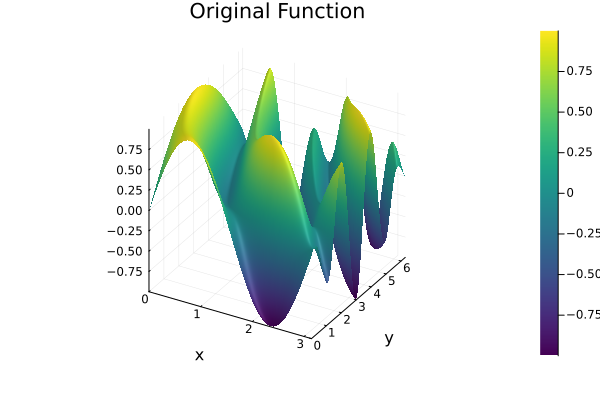

In [36]:
    # Number of qubits per dimension
    N = 7  # You can change this to N = 7 if resources permit
    num_points = 2^N
        
        # Define the x and y grids
    x_vals = range(0, π, length=num_points)
    y_vals = range(0, 2π, length=num_points)
     # Define the function
    f(x, y) = sin(x + y) * cos(x * y)
    
    # Compute the function values and store in a matrix F
    F = [f(x, y) for x in x_vals, y in y_vals]
    p1 = surface(x_vals, y_vals, F, 
             title="Original Function", 
             xlabel="x", ylabel="y", 
             color=:viridis)
    

In [41]:
sites = siteinds("Qubit", 2*N);
A_F=reshape(F,num_points^2);
M = MPS(A_F,sites)

Contraction resulted in ITensor with 14 indices, which is greater
            than or equal to the ITensor order warning threshold 14.
            You can modify the threshold with macros like `@set_warn_order N`,
            `@reset_warn_order`, and `@disable_warn_order` or functions like
            `ITensors.set_warn_order(N::Int)`, `ITensors.reset_warn_order()`, and
            `ITensors.disable_warn_order()`.

Stacktrace:
  [1] _contract(A::ITensor, B::ITensor)
    @ ITensors ~/.julia/packages/ITensors/70qev/src/tensor_operations/tensor_algebra.jl:20
  [2] contract(A::ITensor, B::ITensor)
    @ ITensors ~/.julia/packages/ITensors/70qev/src/tensor_operations/tensor_algebra.jl:74
  [3] *
    @ ~/.julia/packages/ITensors/70qev/src/tensor_operations/tensor_algebra.jl:61 [inlined]
  [4] qx(qx::typeof(qr), A::ITensor, Linds::Vector{Index{Int64}}, Rinds::Vector{Index{Int64}}; tags::String, positive::Bool)
    @ ITensors ~/.julia/packages/ITensors/70qev/src/tensor_operations/matrix_decomp

MPS
[1] ((dim=2|id=995|"Qubit,Site,n=1"), (dim=2|id=504|"Link,n=1"))
[2] ((dim=2|id=504|"Link,n=1"), (dim=2|id=239|"Qubit,Site,n=2"), (dim=4|id=796|"Link,n=2"))
[3] ((dim=4|id=796|"Link,n=2"), (dim=2|id=297|"Qubit,Site,n=3"), (dim=8|id=295|"Link,n=3"))
[4] ((dim=8|id=295|"Link,n=3"), (dim=2|id=613|"Qubit,Site,n=4"), (dim=16|id=838|"Link,n=4"))
[5] ((dim=16|id=838|"Link,n=4"), (dim=2|id=355|"Qubit,Site,n=5"), (dim=32|id=627|"Link,n=5"))
[6] ((dim=32|id=627|"Link,n=5"), (dim=2|id=452|"Qubit,Site,n=6"), (dim=64|id=232|"Link,n=6"))
[7] ((dim=64|id=232|"Link,n=6"), (dim=2|id=371|"Qubit,Site,n=7"), (dim=128|id=375|"Link,n=7"))
[8] ((dim=128|id=375|"Link,n=7"), (dim=2|id=646|"Qubit,Site,n=8"), (dim=64|id=351|"Link,n=8"))
[9] ((dim=64|id=351|"Link,n=8"), (dim=2|id=712|"Qubit,Site,n=9"), (dim=32|id=952|"Link,n=9"))
[10] ((dim=32|id=952|"Link,n=9"), (dim=2|id=322|"Qubit,Site,n=10"), (dim=16|id=193|"Link,n=10"))
[11] ((dim=16|id=193|"Link,n=10"), (dim=2|id=647|"Qubit,Site,n=11"), (dim=8|id=935|"L

In [42]:
# Extract bond dimensions of the MPS
bond_dims = [dim(linkind(M, n)) for n in 1:length(M)-1]
println("Bond dimensions without truncation: ", bond_dims)

# The maximal bond dimension is:
max_bond_dim = maximum(bond_dims)
println("Maximal bond dimension without truncation: ", max_bond_dim)

Bond dimensions without truncation: [2, 4, 8, 16, 32, 64, 128, 64, 32, 16, 8, 4, 2]
Maximal bond dimension without truncation: 128


In [44]:
# Desired bond dimension
chi = 3

# Truncate the MPS to the desired bond dimension
psi_trunc = truncate(M; maxdim=chi)

MPS
[1] ((dim=2|id=995|"Qubit,Site,n=1"), (dim=2|id=33|"Link,n=1"))
[2] ((dim=2|id=239|"Qubit,Site,n=2"), (dim=3|id=313|"Link,n=2"), (dim=2|id=33|"Link,n=1"))
[3] ((dim=2|id=297|"Qubit,Site,n=3"), (dim=3|id=131|"Link,n=3"), (dim=3|id=313|"Link,n=2"))
[4] ((dim=2|id=613|"Qubit,Site,n=4"), (dim=3|id=870|"Link,n=4"), (dim=3|id=131|"Link,n=3"))
[5] ((dim=2|id=355|"Qubit,Site,n=5"), (dim=3|id=193|"Link,n=5"), (dim=3|id=870|"Link,n=4"))
[6] ((dim=2|id=452|"Qubit,Site,n=6"), (dim=3|id=806|"Link,n=6"), (dim=3|id=193|"Link,n=5"))
[7] ((dim=2|id=371|"Qubit,Site,n=7"), (dim=3|id=160|"Link,n=7"), (dim=3|id=806|"Link,n=6"))
[8] ((dim=2|id=646|"Qubit,Site,n=8"), (dim=3|id=204|"Link,n=8"), (dim=3|id=160|"Link,n=7"))
[9] ((dim=2|id=712|"Qubit,Site,n=9"), (dim=3|id=901|"Link,n=9"), (dim=3|id=204|"Link,n=8"))
[10] ((dim=2|id=322|"Qubit,Site,n=10"), (dim=3|id=722|"Link,n=10"), (dim=3|id=901|"Link,n=9"))
[11] ((dim=2|id=647|"Qubit,Site,n=11"), (dim=3|id=696|"Link,n=11"), (dim=3|id=722|"Link,n=10"))
[12] (

In [45]:
bond_dims = [dim(linkind(psi_trunc , n)) for n in 1:length(psi_trunc )-1]
println("Bond dimensions without truncation: ", bond_dims)

# The maximal bond dimension is:
max_bond_dim = maximum(bond_dims)
println("Maximal bond dimension without truncation: ", max_bond_dim)

Bond dimensions without truncation: [2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2]
Maximal bond dimension without truncation: 3


In [51]:
#T_trunc = psi_trunc 

# Extract the data from the ITensor
f_approx_vec = Matrix(psi_trunc)




LoadError: MethodError: no method matching (Matrix)(::MPS)

[0mClosest candidates are:
[0m  (Array{<:Any, N})([91m::ITensor[39m, Any...) where N
[0m[90m   @[39m [35mITensors[39m [90m~/.julia/packages/ITensors/70qev/src/[39m[90m[4mitensor.jl:723[24m[39m
[0m  (Matrix)([91m::UndefInitializer[39m, [91m::Integer[39m, [91m::Integer[39m)
[0m[90m   @[39m [90mBase[39m [90m[4mbaseext.jl:33[24m[39m
[0m  (Matrix)([91m::UpperTriangular{T, S} where S<:AbstractMatrix{T}[39m) where T
[0m[90m   @[39m [33mLinearAlgebra[39m [90m/Applications/Julia-1.10.app/Contents/Resources/julia/share/julia/stdlib/v1.10/LinearAlgebra/src/[39m[90m[4mtriangular.jl:34[24m[39m
[0m  ...


In [ ]:
grid_size = 2^N
# Reshape the vector back to the original 2D grid shape
f_approx = reshape(f_approx_vec, grid_size, grid_size)

# Plotting the original and approximated functions

# Create a meshgrid for plotting
X, Y = meshgrid(x_vals, y_vals)

# Plot the original function
plot1 = surface(X, Y, f_vals'; title="Original Function", xlabel="x", ylabel="y", zlabel="f(x, y)")
display(plot1)

# Plot the approximated function after truncation
plot2 = surface(X, Y, f_approx'; title="Approximated Function (χ=3)", xlabel="x", ylabel="y", zlabel="f(x, y)")
display(plot2)

# Plot the difference between the original and approximated functions
difference = abs.(f_vals - f_approx)
plot3 = contour(X, Y, difference'; title="Difference |Original - Approximated|", xlabel="x", ylabel="y")
display(plot3)